<a href="https://colab.research.google.com/github/dotimothy/astronomy/blob/main/analysis/ImageStacking.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ImageStacking 📚

This notebook aims to explore the purpose of Image Stacking and observe how capturing multiple short exposures is advantegeous than one single exposure for Astrophotography. 

**Author:** [Timothy Do](https://timothydo.me)

## References
[1] PhotographingSpace.com. (2023, December 22). Homework: Download and Stack my Data! [Online]. Available: https://www.photographingspace.com/homework-download-stack-data/ <br>
[2] Ethan Rublee, Vincent Rabaud, Kurt Konolige, and Gary Bradski. ORB: an efficient alternative to SIFT or SURF. In 2011 IEEE International Conference on Computer Vision (ICCV), 1  pages 2564–2571. IEEE, 2011.

## Dependencies

In [1]:
IN_COLAB = True
try: 
    import google.colab
except: 
    IN_COLAB = False
print(f'In CoLab: {IN_COLAB}')

In CoLab: False


In [2]:
if(IN_COLAB):
    !curl https://raw.githubusercontent.com/dotimothy/astronomy/main/requirements.txt -o ./requirements.txt
    !pip install -r requirements.txt
else:
    !pip install -r ../requirements.txt

In [3]:
# Dependencies
import os
import numpy as np
import rawpy
import cv2 as cv
import matplotlib.pyplot as plt 
from tqdm import tqdm

In [4]:
# Global Helper Functions
# Crudely Normalize an Image (float) from 0-1
def normalize(img):
    return (img - img.min())/(img.max()-img.min())

# Contrast Stretches an Image (float)
def contrast_stretch(img,min=0,max=1):
    return np.clip(normalize(img) * (max-min) + min,a_min=0,a_max=1)

# Convert a uint8 image to a float image
def int_to_float(img):
    return normalize(img.astype(np.float))

# Convert a float image to a uint8 image
def float_to_int(img):
    return (255.0*normalize(img)).astype(np.uint8)

# Converts CR2 to Numpy Array
def cr2_to_numpy(cr2Path,uint=False):
    with rawpy.imread(cr2Path) as raw:
        if(uint):
            out = raw.postprocess() # uint8
        else:
            out = raw.postprocess(use_camera_wb=True,half_size=False,output_bps=16,no_auto_bright=False)
            out = out.astype(np.float32)/ 2**16
    return out

## Downloading the Data
For exploring the process of Image Stacking, we will be downloading a "Homework" example from Cory Schmitz's blog in the Photograph Space site! He takes a really nice shot of the milky way that we can work with. [1]

Here are some logisitcs of the stack, taken on a static tripod: 

- **Camera:** Canon 5D Mark III 
- **ISO:** 6400
- **Exposure Length:** 15 seconds
- **White Balance:** 4250K

In [5]:
# Creating Directory to Store the Data
dataDir = '../data/imagestacking'
os.makedirs(dataDir,exist_ok=True)

In [6]:
# Downloading the Single Raw Image & Full Stack
site = "https://www.photographingspace.com/downloads/"
singleRawFile = "CSM30803.CR2"
stackFile = "11x_ISO6400_f2.8_15s_5DMkIII_raw.zip"
for file in [singleRawFile,stackFile]: 
    filePath = f'{dataDir}/{file}'
    if(not(os.path.exists(filePath))):
        fileLink = f'{site}/{file}'
        os.system(f'curl {fileLink} -o {filePath}')
    if(file.endswith('.zip')):
        zipDir = filePath.split('.zip')[0]
        if(not(os.path.exists(zipDir))):
            os.system(f'unzip {filePath} -d {zipDir}')

## Visualizing the Data

Single Raw Numpy Shape: (3870, 5796, 3)
Single Raw Numpy Data Type: float32


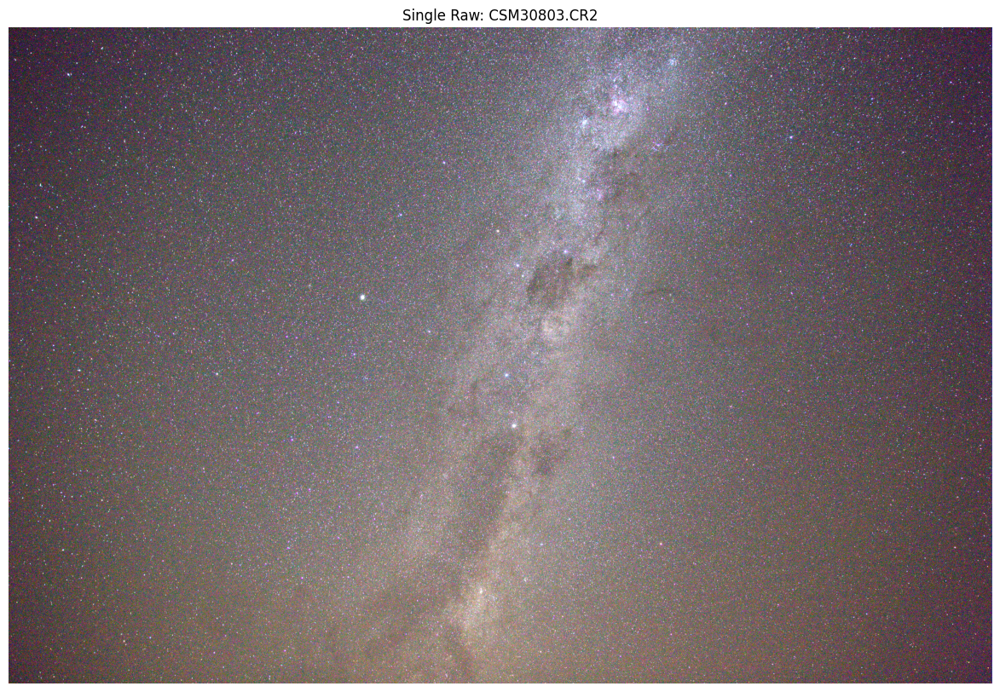

In [26]:
# Extracting Single Raw Image & Viewing
singleRawPath = f'{dataDir}/{singleRawFile}'
singleRaw = cr2_to_numpy(singleRawPath)
print(f'Single Raw Numpy Shape: {singleRaw.shape}')
print(f'Single Raw Numpy Data Type: {singleRaw.dtype}')
cv.imwrite(f"{dataDir}/{singleRawFile.strip('.CR2')}.png",float_to_int(singleRaw)[...,::-1])

# Plotting
plt.figure(figsize=(15,10))
plt.title(f'Single Raw: {singleRawFile}')
plt.imshow(contrast_stretch(singleRaw))
plt.axis('off')
plt.show()

In [8]:
# Read the Stacks into Memory
stackPath = f'{dataDir}/11x_ISO6400_f2.8_15s_5DMkIII_raw/raw'
stackFiles = sorted([file for file in os.listdir(stackPath) if file.endswith('.CR2')])
print(f'Stack Files: {stackFiles}')
print('Stacking Raw Images into a Tensor')
stackedNumpy = np.stack([cr2_to_numpy(f'{stackPath}/{stackFile}') for stackFile in tqdm(stackFiles)])
print(f'Stacked Numpy Shape: {stackedNumpy.shape}')
print(f'Stacked Numpy Data Type: {stackedNumpy.dtype}')

Stack Files: ['CSM30799.CR2', 'CSM30800.CR2', 'CSM30801.CR2', 'CSM30802.CR2', 'CSM30803.CR2', 'CSM30804.CR2', 'CSM30805.CR2', 'CSM30806.CR2', 'CSM30807.CR2', 'CSM30808.CR2', 'CSM30809.CR2']
Stacking Raw Images into a Tensor


100%|██████████| 11/11 [00:08<00:00,  1.32it/s]


Stacked Numpy Shape: (11, 3870, 5796, 3)
Stacked Numpy Data Type: float32


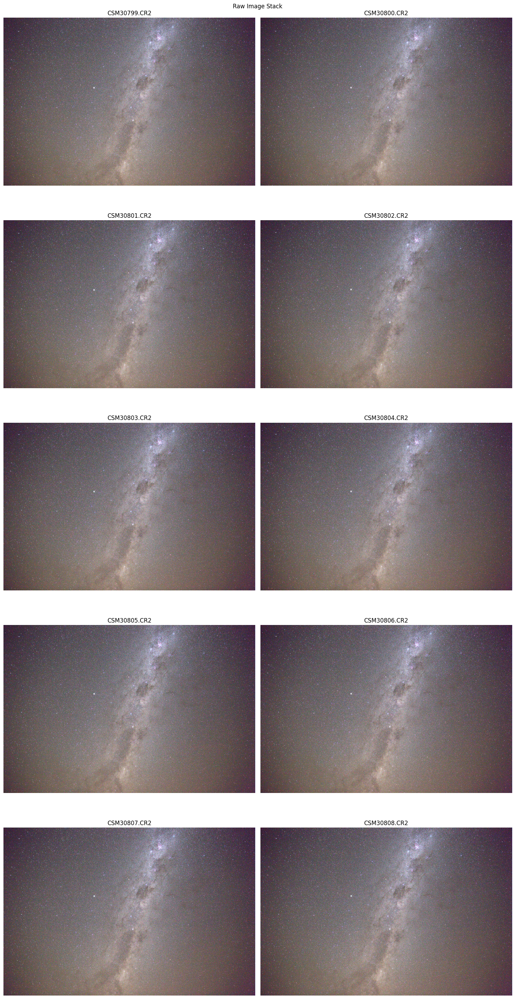

In [9]:
# Viewing the Stack
rows = 5
cols = 2
fig, ax = plt.subplots(nrows=rows,ncols=cols,figsize=(15,30))
plt.suptitle('Raw Image Stack')
for i in range(rows):
    for j in range(cols):
        ax[i][j].axis('off')
        ax[i][j].set_title(stackFiles[(i*cols)+j])
        ax[i][j].imshow(contrast_stretch(stackedNumpy[(i*cols)+j]))
plt.tight_layout()
plt.show()

## Stacking Methods
 We will explore stacking methods in order to reduce noise and have the deep sky objects really pop out! We first start off with Naive methods, which work by avergaing the images to filter noise. The noise is coming from the shot, coming from readout, thermal, etc. 
The noise can modeled as additive as shown below: $$I(x,y) = f(x,y) + n(x,y)$$ $$n(x,y) \sim \mathcal{N}(\mu,\sigma^2)$$, where it is assumed zero-mean and unit variance (i.e., $\mu = 0, \sigma = 1$).
 
Averaging works in the ideal setting (i.e., when there is no parallax between scenes), but not in the real world because of star trails. Star trails are caused when the stars rotate with the Earth's rotation in perspective of the shot, so we need to perform image registartion before stacking the images!

### Simulation

We first provide an ideal scene, where a test scene is generated with a simulated deep sky object.

In [10]:
# Helper Functions to Simulate Noise
# Creating Test Scene 
def createTestScene(width=64,height=64,radius=5):
    # Image dimensions
    # Create an empty image (black background)
    image = np.zeros((height, width,3))

    # Define circle parameters
    center_x = width // 2
    center_y = height // 2

    # Create a meshgrid
    y, x = np.ogrid[-center_y:height-center_y, -center_x:width-center_x]

    # Calculate distance from center
    dist_from_center = np.sqrt(x**2 + y**2)

    # Set pixels within the circle to white
    image[dist_from_center <= radius] = 1
    return image

# Genereates Noise with Zero Mean and Unit Variance 
def createNoise(width=64,height=64,dist='uniform'):
    if(dist == 'uniform'):
        noise = np.random.rand(height,width,3)
    elif(dist == 'gauss'):
        noise = np.random.randn(height,width,3)
    return normalize(noise)

Test Scene Shape: (64, 64, 3)
Test Scene Data Type: float64


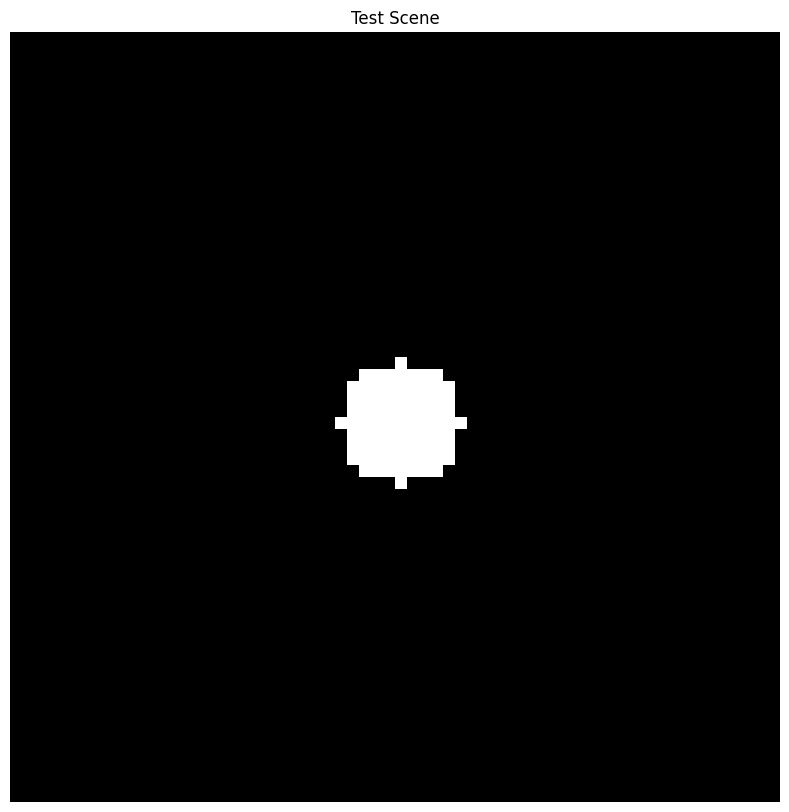

In [11]:
testScene = createTestScene()
print(f'Test Scene Shape: {testScene.shape}')
print(f'Test Scene Data Type: {testScene.dtype}')
plt.figure(figsize=(15,10))
plt.imshow(testScene)
plt.title('Test Scene')
plt.axis('off')
plt.show()

Test Noise Shape: (64, 64, 3)
Test Noise Data Type: float64
Test Noise Min: 0.0
Test Noise Max: 1.0


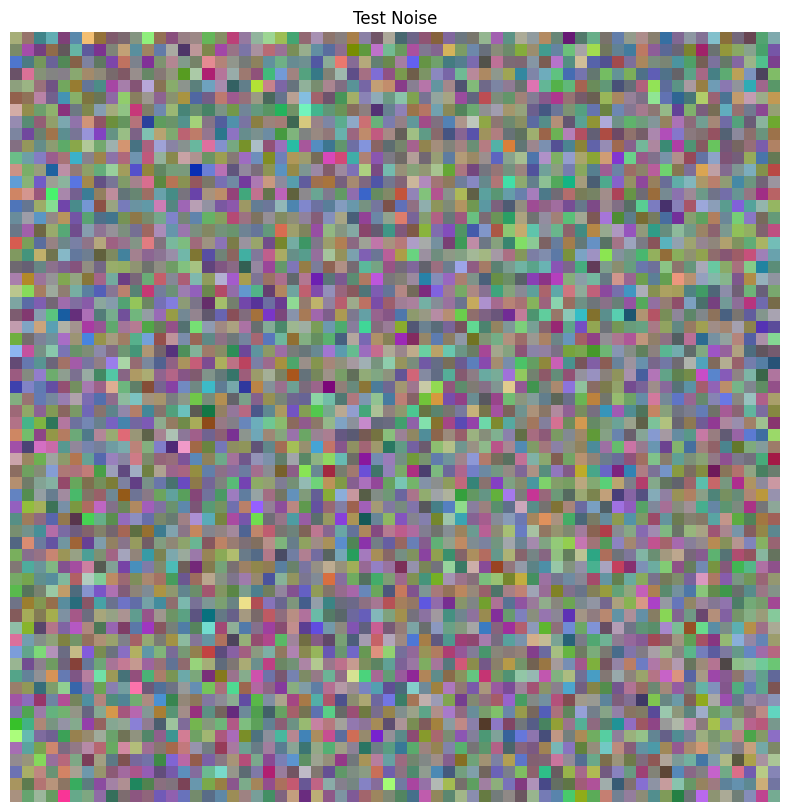

In [12]:
testNoise = createNoise(dist='gauss')
print(f'Test Noise Shape: {testNoise.shape}')
print(f'Test Noise Data Type: {testNoise.dtype}')
print(f'Test Noise Min: {testNoise.min()}')
print(f'Test Noise Max: {testNoise.max()}')
plt.figure(figsize=(15,10))
plt.imshow(testNoise)
plt.title('Test Noise')
plt.axis('off')
plt.show()

In [13]:
# Generate the Noisy Stack 
scale = 1
numStack = 2500
print('Creating Test Stack...')
testStack = np.stack([normalize(testScene + scale*createNoise(dist='uniform')) for _ in tqdm(range(numStack))])
print(f'Test Stack Shape: {testStack.shape}')

Creating Test Stack...


100%|██████████| 2500/2500 [00:00<00:00, 20329.16it/s]

Test Stack Shape: (2500, 64, 64, 3)


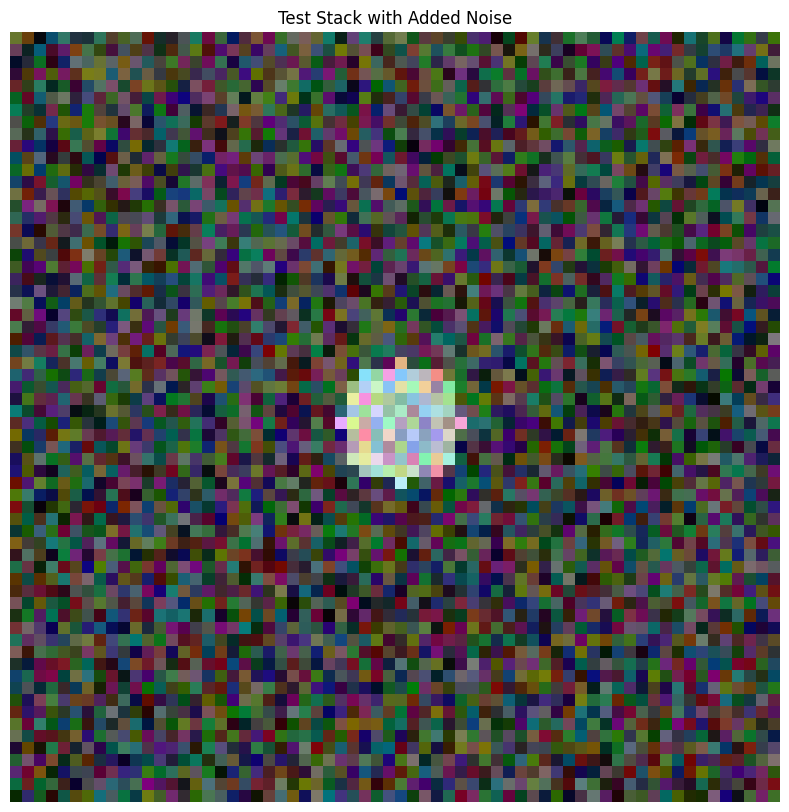

In [14]:
plt.figure(figsize=(15,10))
plt.title('Test Stack with Added Noise')
plt.axis('off')
plt.imshow(contrast_stretch(testStack[0]))
plt.show()

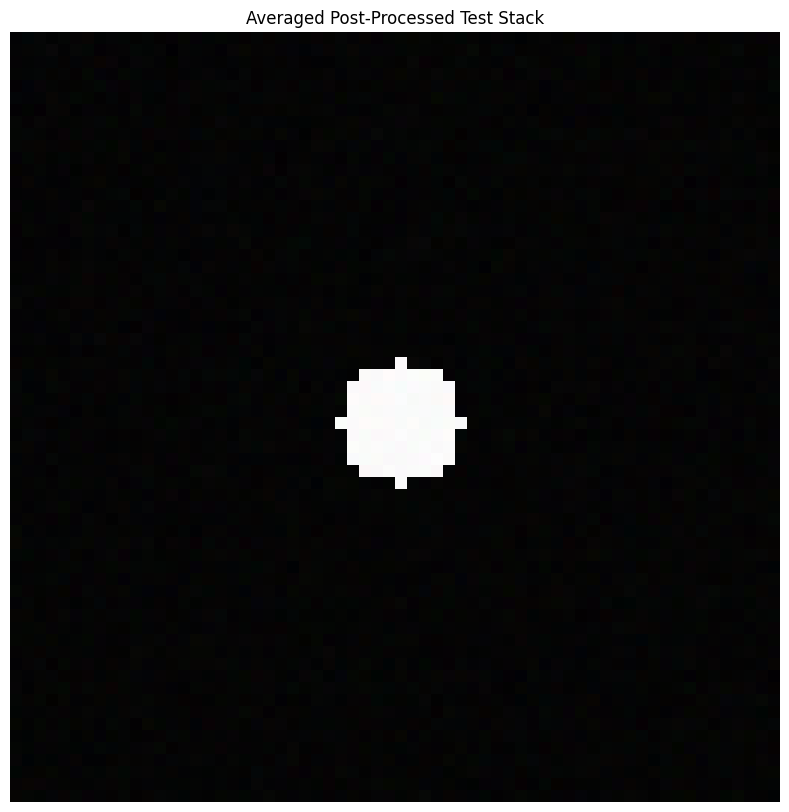

In [15]:
# Viewing the Average Raw Image (Naive Stacking)
testMean = np.mean(testStack,axis=0)
# Plotting the Average
plt.figure(figsize=(15,10))
plt.title(f'Averaged Post-Processed Test Stack')
plt.imshow(contrast_stretch(testMean))
plt.axis('off')
plt.show()

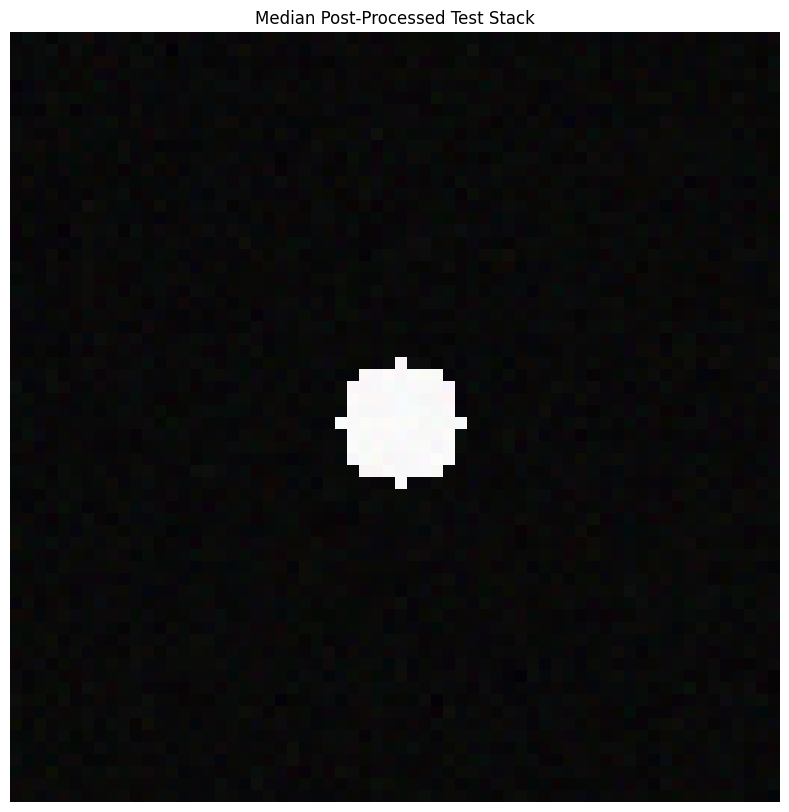

In [16]:
# Viewing the Median Raw Image (Naive Stacking)
testMedian = np.median(testStack,axis=0)
# Plotting the Average
plt.figure(figsize=(15,10))
plt.title(f'Median Post-Processed Test Stack')
plt.imshow(contrast_stretch(testMedian))
plt.axis('off')
plt.show()

### Real Images

As seen above, averaging the noisy image stack elimiantes the zero mean noise, that's because as many samples, it models the  distribution of the noise, which is $\sigma(0,1)$. However, the assumption is the scene is static, which is not the case for the Earth's constant rotation.

Every day, the Earth approximately rotates by 360 degrees, translating to 0.25 degrees a minute. Naively stacking all the images leads to translational error, visually seen in the form of star trails as shown below.

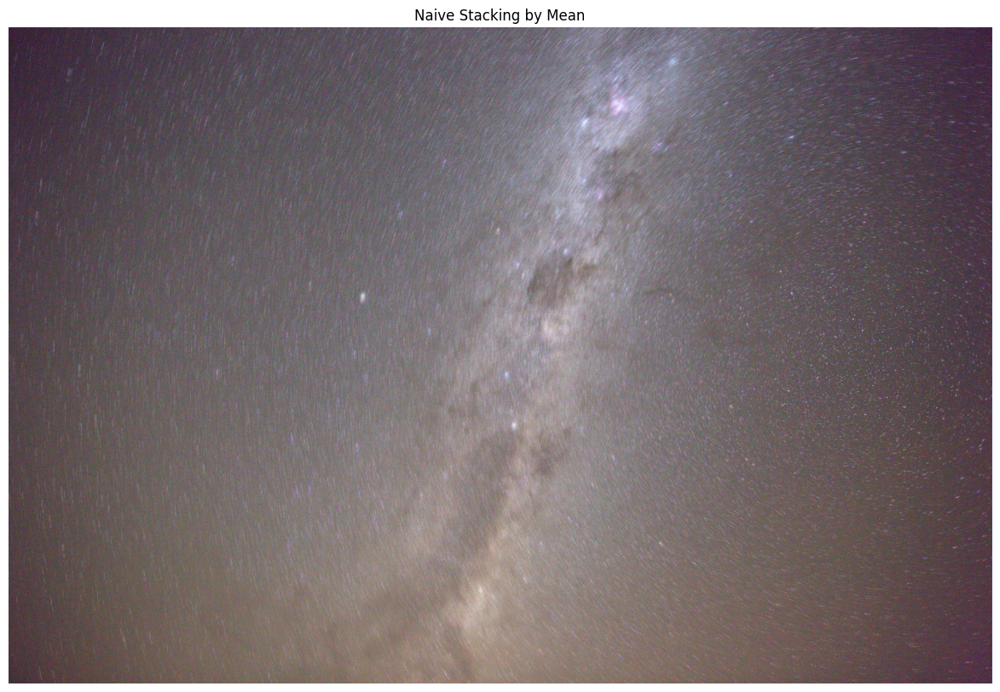

In [17]:
# Viewing the Average Raw Image (Naive Stacking)
stackedMean = np.mean(stackedNumpy,axis=0)
# Plotting the Average
plt.figure(figsize=(15,10))
plt.title(f'Naive Stacking by Mean')
plt.imshow(contrast_stretch(stackedMean))
plt.axis('off')
plt.show()

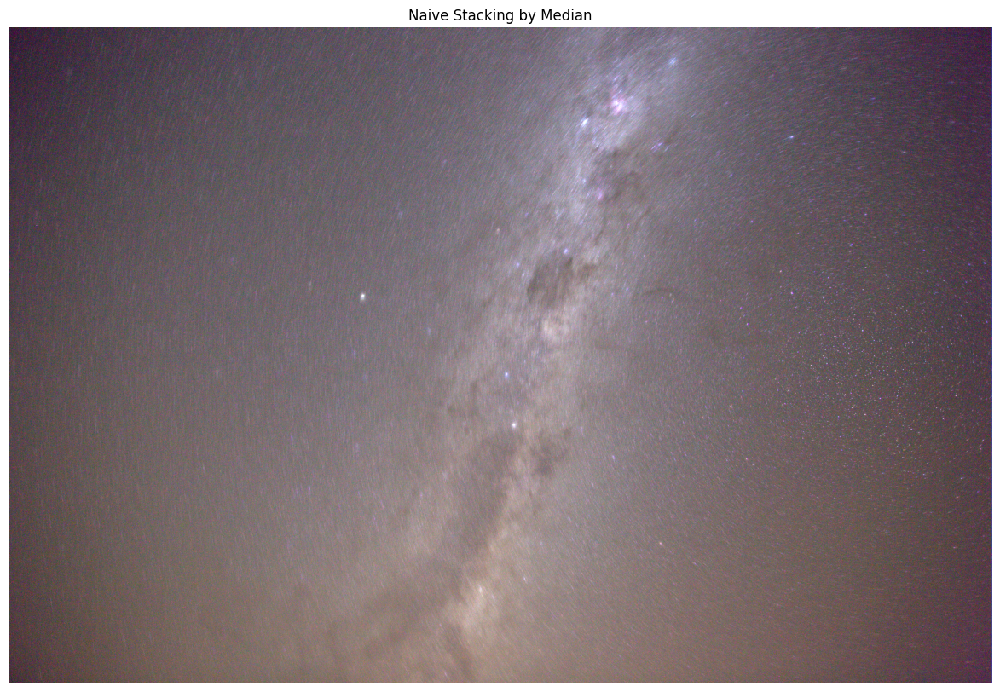

In [18]:
# Viewing the Median Raw Image (Naive Stacking)
stackedMedian = np.median(stackedNumpy,axis=0)
# Plotting the Median
plt.figure(figsize=(15,10))
plt.title(f'Naive Stacking by Median')
plt.imshow(contrast_stretch(stackedMedian))
plt.axis('off')
plt.show()

### Image Registration
In order to correctly stack many astrophotography long exposures, a preprocessing operation of image registration needs to occur to align the images. ORB Image registration finds common keypoints between an image and a reference, estimates the transformation matrix, and maps the new pixels with respect to the reference to correct rotation [2]. This will mitigate the prescence of star trails and allow us to accurately stack our images for a nice celestial object!

In [19]:
# Registers a Float Img (img2) with Respect to a Reference (img1)
def register_image(img1,img2,numFeatures=20000,match=0.95,refill=True):
    # Convert to uint8 grayscale.
    gray1 = cv.cvtColor(float_to_int(img1), cv.COLOR_BGR2GRAY)
    gray2 = cv.cvtColor(float_to_int(img2), cv.COLOR_BGR2GRAY)
    height, width = gray1.shape
    
    # Create ORB detector
    orb_detector = cv.ORB_create(numFeatures)
    
    # Find keypoints and descriptors.
    # The first arg is the image, second arg is the mask
    #  (which is not required in this case).
    kp1, d1 = orb_detector.detectAndCompute(gray1, None)
    kp2, d2 = orb_detector.detectAndCompute(gray2, None)
    
    # Match features between the two images.
    # We create a Brute Force matcher with 
    # Hamming distance as measurement mode.
    matcher = cv.BFMatcher(cv.NORM_HAMMING, crossCheck = True)
    
    # Match the two sets of descriptors.
    matches = list(matcher.match(d1, d2))

    
    # Sort matches on the basis of their Hamming distance.
    matches.sort(key = lambda x: x.distance)
    
    # Take the top matches forward.
    matches = matches[:int(len(matches)*match)]
    no_of_matches = len(matches)
    
    # Define empty matrices of shape no_of_matches * 2.
    p1 = np.zeros((no_of_matches, 2))
    p2 = np.zeros((no_of_matches, 2))
    
    for i in range(len(matches)):
      p1[i, :] = kp1[matches[i].queryIdx].pt
      p2[i, :] = kp2[matches[i].trainIdx].pt
    
    # Find the homography matrix.
    homography, mask = cv.findHomography(p1, p2, cv.RANSAC)
    
    # Use this matrix to transform the
    # colored image wrt the reference image.
    transformed_img = cv.warpPerspective(img1,
                        homography, (width, height))

    if(refill): 
        transformed_img = np.where(transformed_img != 0, transformed_img, img2) 
    
    return transformed_img

# Stacks Images with Automatic Alignment
def stack_images(imgStack,method='mean',align=True,refIndex=0.5,refill=True):
    if align:
        refIndex = len(imgStack) // 2 if refIndex == 0.5 else refIndex
        newImgs = []
        for i in tqdm(range(imgStack.shape[0])): 
            newImgs.append(normalize(imgStack[i]) if i == refIndex else register_image(imgStack[i],imgStack[refIndex],refill=refill))
        imgStack = np.stack(newImgs)
    stackedImg = np.median(imgStack,axis=0) if method == 'med' else np.mean(imgStack,axis=0)
    return stackedImg

In [24]:
# Stacking the Astro Image
stackedImg = stack_images(stackedNumpy,refIndex=0)

100%|██████████| 11/11 [00:16<00:00,  1.53s/it]


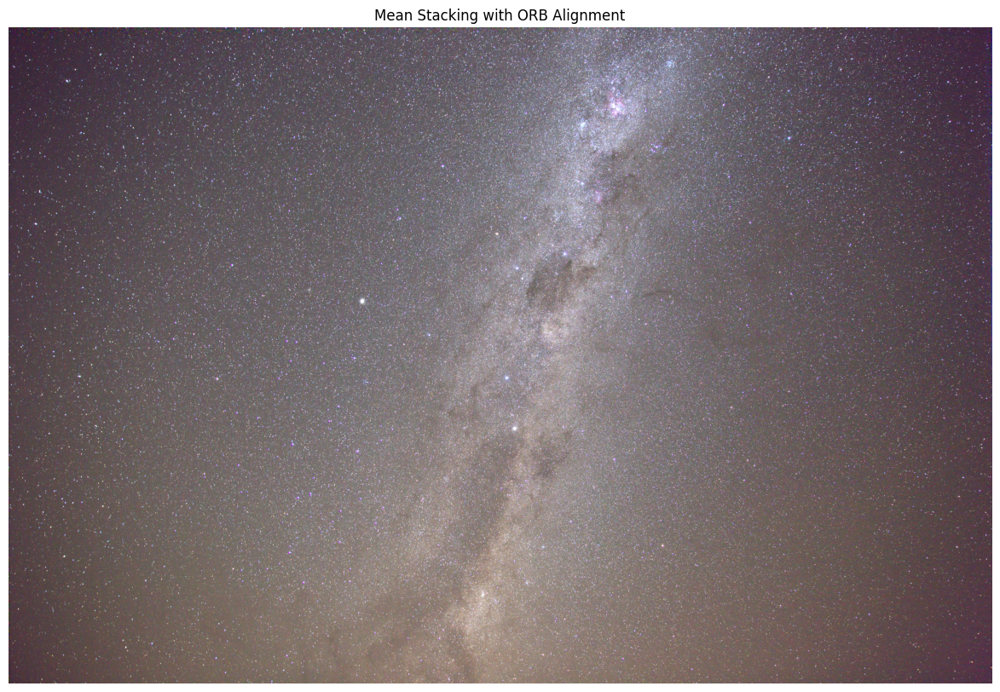

In [25]:
# Plotting the Stacked Image
plt.figure(figsize=(15,10))
plt.title(f'Mean Stacking with ORB Alignment')
plt.imshow(contrast_stretch(stackedImg))
plt.axis('off')
plt.show()

In [27]:
# Writing the Final Result
cv.imwrite(f'{dataDir}/stackedImg.png',float_to_int(stackedImg)[...,::-1])

True

Now with Image Registration, we have succesfully merged our Astrophoto stack using Python! Feel free to apply any postprocessing tactics to make the images look nice!